<a href="https://colab.research.google.com/github/kungfumas/aplikasi-deep-learning/blob/master/GANDeOldify3ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!git clone https://github.com/jantic/DeOldify.git DeOldify

fatal: destination path 'DeOldify' already exists and is not an empty directory.


In [9]:
cd DeOldify

[Errno 2] No such file or directory: 'DeOldify'
/content/DeOldify


In [4]:
#NOTE:  This must be the first call in order to work properly!
from deoldify import device
from deoldify.device_id import DeviceId
#choices:  CPU, GPU0...GPU7
device.set(device=DeviceId.GPU0)

import torch

if not torch.cuda.is_available():
    print('GPU not available.')

In [12]:
!pip install -r requirements-colab.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 237.3/237.3 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 18.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 631.4/631.4 kB 26.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.1/354.1 kB 35.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 41.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.4/194.4 kB 28.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 57.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 16.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using 

In [13]:
!cd ..


In [14]:
!dir

ColorFIDBenchmarkArtistic.ipynb		ImageColorizerStableTests.ipynb
ColorizeTrainingArtistic.ipynb		LICENSE
ColorizeTrainingStable.ipynb		MANIFEST.in
ColorizeTrainingStableLargeBatch.ipynb	models
ColorizeTrainingVideo.ipynb		README.md
ColorizeTrainingWandb.ipynb		requirements-colab.txt
deoldify				requirements-dev.txt
environment.yml				requirements.txt
fastai					resource_images
fid					setup.py
ImageColorizerArtisticTests.ipynb	test_images
ImageColorizerColab.ipynb		tox.ini
ImageColorizerColabStable.ipynb		VideoColorizerColab.ipynb
ImageColorizer.ipynb			VideoColorizer.ipynb


In [15]:
import fastai
from deoldify.visualize import *
import warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*?Your .*? set is empty.*?")

In [16]:
!mkdir 'models'
!wget https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth -O ./models/ColorizeArtistic_gen.pth

mkdir: cannot create directory ‘models’: File exists
--2024-06-12 05:04:16--  https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth
Resolving data.deepai.org (data.deepai.org)... 169.150.249.169, 2400:52e0:1a01::900:1
Connecting to data.deepai.org (data.deepai.org)|169.150.249.169|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 255144681 (243M) [application/octet-stream]
Saving to: ‘./models/ColorizeArtistic_gen.pth’

./models/ColorizeAr 100%[===================>] 243.32M  5.19MB/s    in 49s     

2024-06-12 05:05:06 (4.92 MB/s) - ‘./models/ColorizeArtistic_gen.pth’ saved [255144681/255144681]



In [22]:
!wget https://github.com/jantic/DeOldify/blob/master/resource_images/watermark.png -O ./resource_images/watermark.png

--2024-06-12 05:08:25--  https://github.com/jantic/DeOldify/blob/master/resource_images/watermark.png
Resolving github.com (github.com)... 140.82.116.3
Connecting to github.com (github.com)|140.82.116.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘./resource_images/watermark.png’

./resource_images/w     [ <=>                ] 156.89K  --.-KB/s    in 0.03s   

2024-06-12 05:08:25 (4.89 MB/s) - ‘./resource_images/watermark.png’ saved [160653]



In [23]:
colorizer = get_image_colorizer(artistic=True)

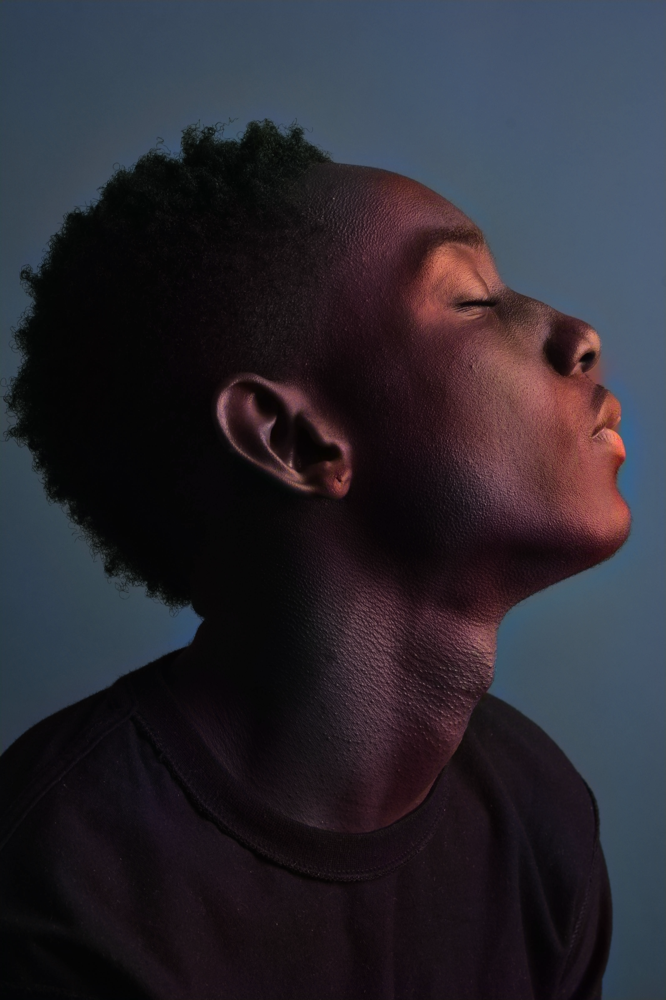

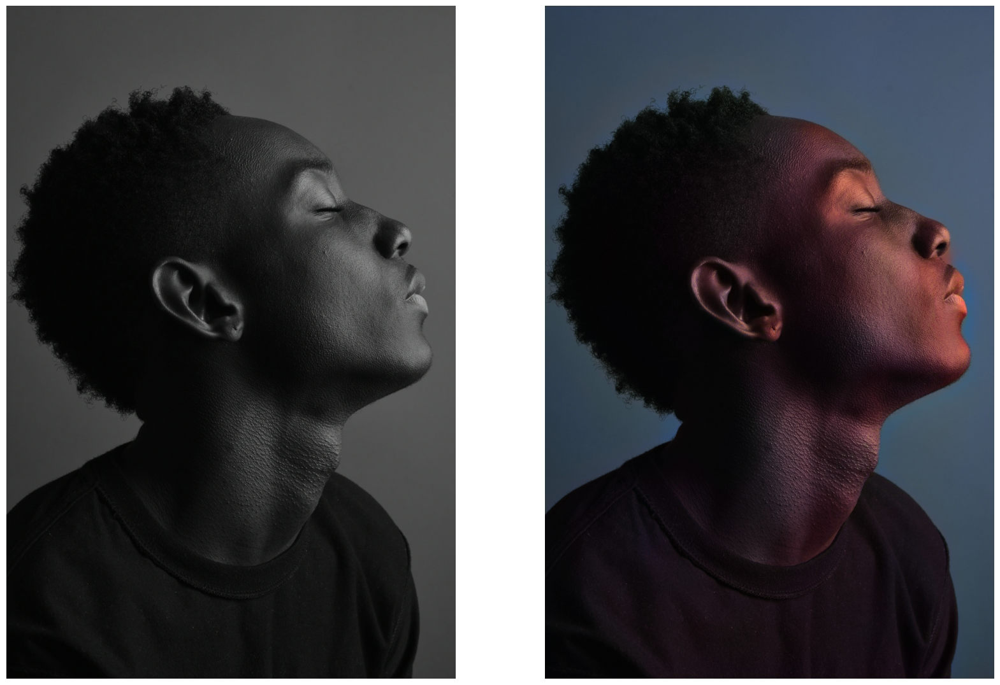

In [24]:
source_url = 'https://images.pexels.com/photos/3031397/pexels-photo-3031397.jpeg'
render_factor = 35
watermarked = True
image_path = colorizer.plot_transformed_image_from_url(url=source_url, render_factor=render_factor, compare=True, watermarked=watermarked)

show_image_in_notebook(image_path)

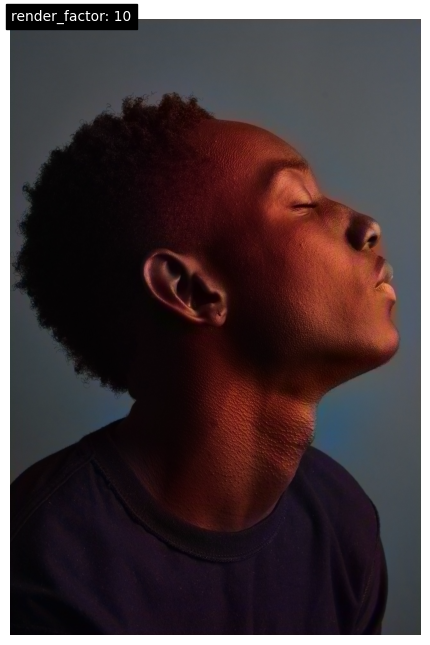

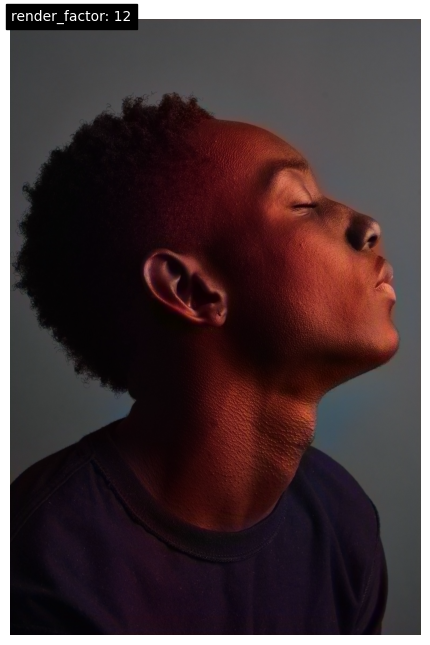

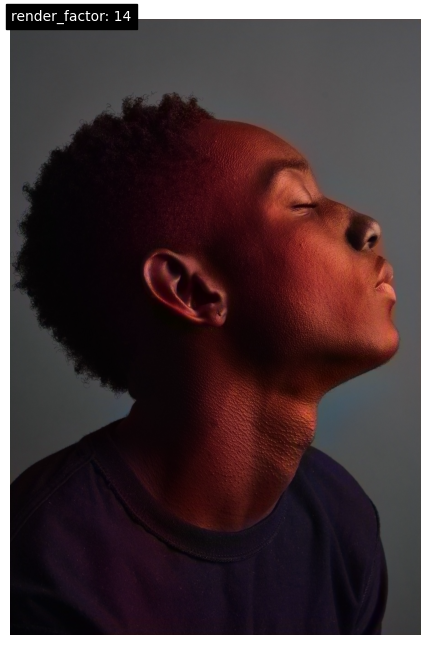

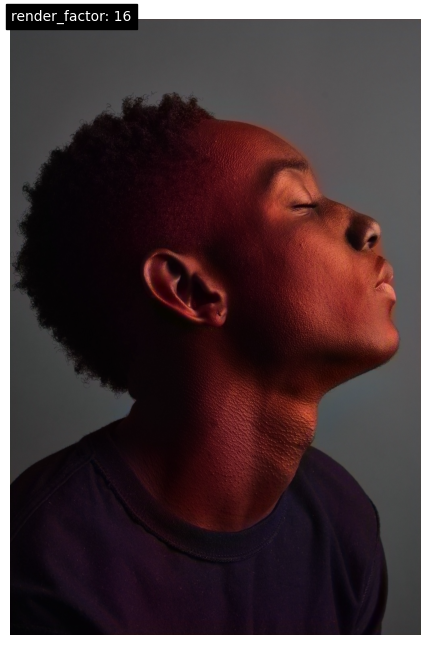

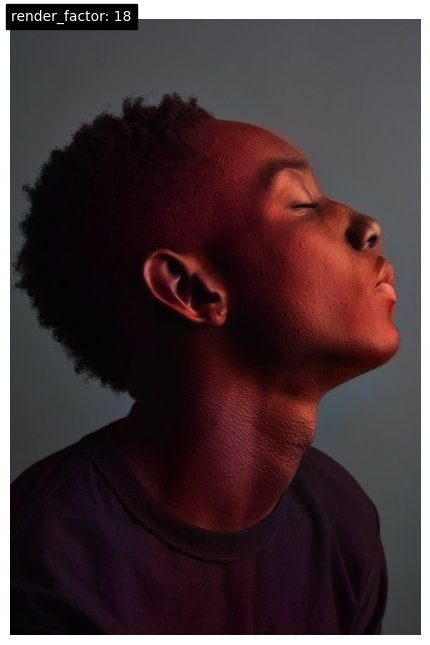

...

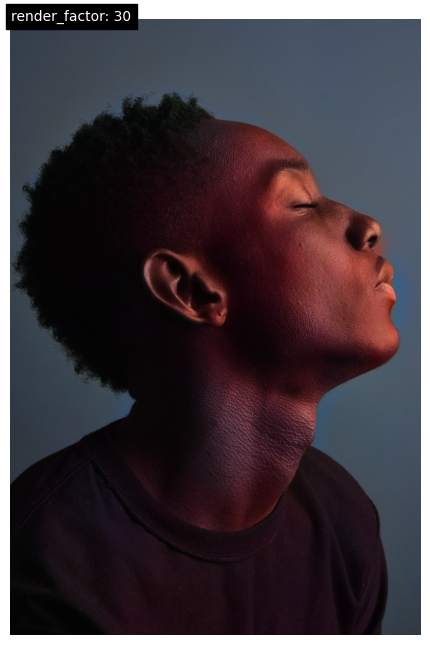

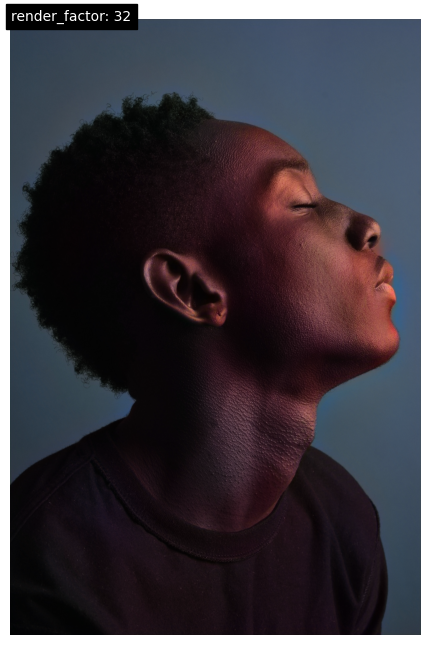

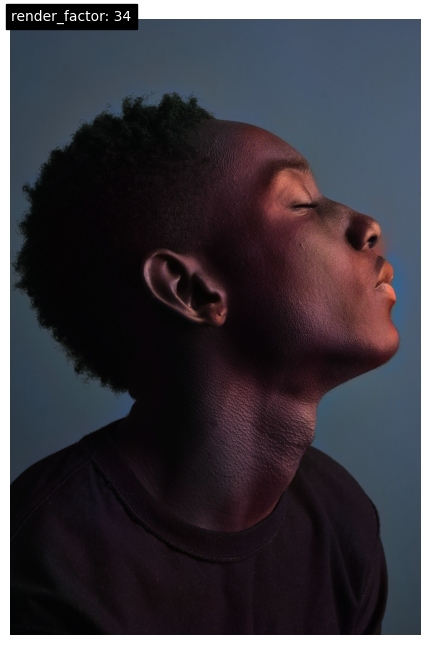

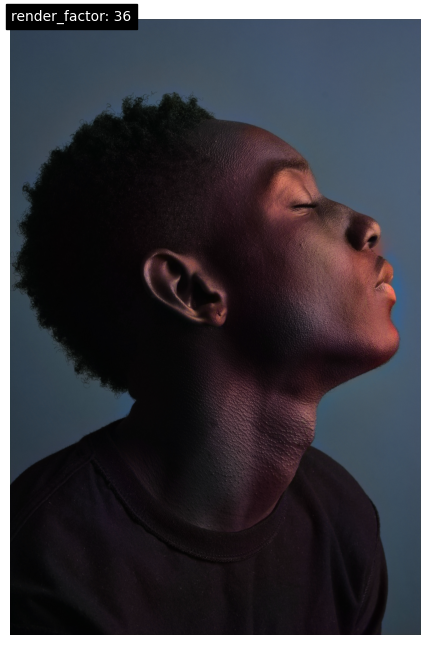

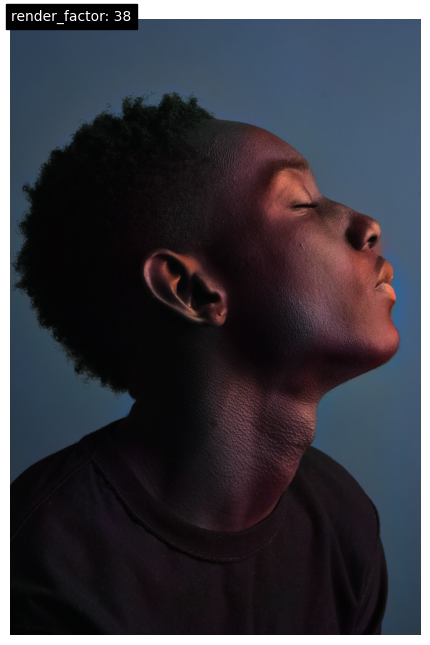

In [25]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/image.png', render_factor=i, display_render_factor=True, figsize=(8,8))

In [26]:
!wget http://4.bp.blogspot.com/-fVkJjgMN4Vg/U7Y5et2ki5I/AAAAAAAARYg/mJUg8WWiBIA/s1600/Kantor_Pos_dan_gubernuran.jpg

--2024-06-12 05:12:09--  http://4.bp.blogspot.com/-fVkJjgMN4Vg/U7Y5et2ki5I/AAAAAAAARYg/mJUg8WWiBIA/s1600/Kantor_Pos_dan_gubernuran.jpg
Resolving 4.bp.blogspot.com (4.bp.blogspot.com)... 74.125.199.132, 2607:f8b0:400e:c02::84
Connecting to 4.bp.blogspot.com (4.bp.blogspot.com)|74.125.199.132|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168332 (164K) [image/jpeg]
Saving to: ‘Kantor_Pos_dan_gubernuran.jpg’

Kantor_Pos_dan_gube 100%[===================>] 164.39K  --.-KB/s    in 0.001s  

2024-06-12 05:12:09 (164 MB/s) - ‘Kantor_Pos_dan_gubernuran.jpg’ saved [168332/168332]



ColorFIDBenchmarkArtistic.ipynb		Kantor_Pos_dan_gubernuran.jpg
ColorizeTrainingArtistic.ipynb		LICENSE
ColorizeTrainingStable.ipynb		MANIFEST.in
ColorizeTrainingStableLargeBatch.ipynb	models
ColorizeTrainingVideo.ipynb		README.md
ColorizeTrainingWandb.ipynb		requirements-colab.txt
deoldify				requirements-dev.txt
environment.yml				requirements.txt
fastai					resource_images
fid					result_images
ImageColorizerArtisticTests.ipynb	setup.py
ImageColorizerColab.ipynb		test_images
ImageColorizerColabStable.ipynb		tox.ini
ImageColorizer.ipynb			VideoColorizerColab.ipynb
ImageColorizerStableTests.ipynb		VideoColorizer.ipynb


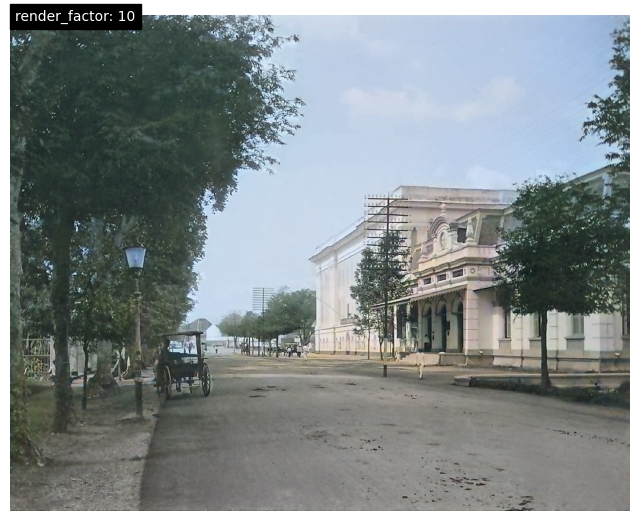

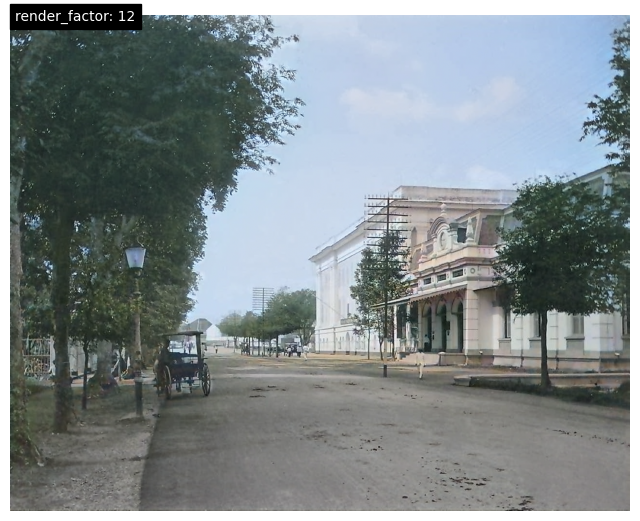

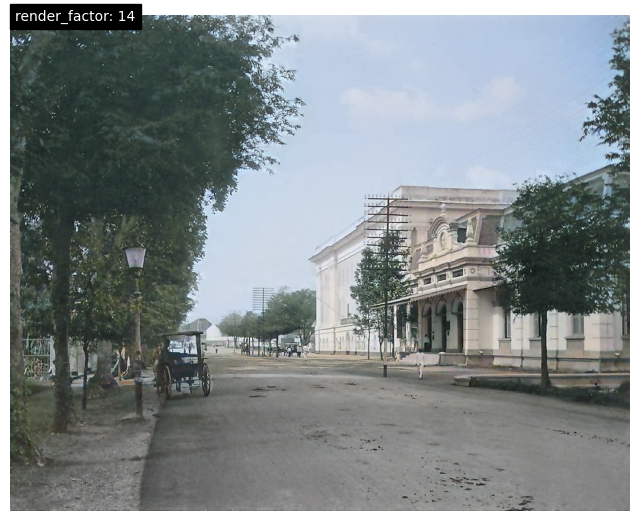

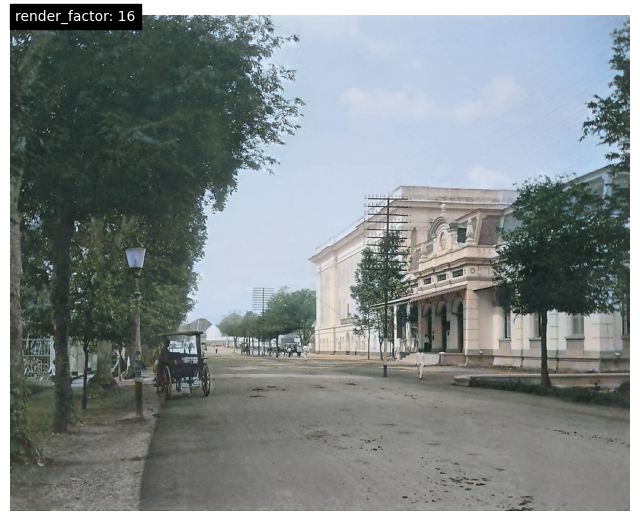

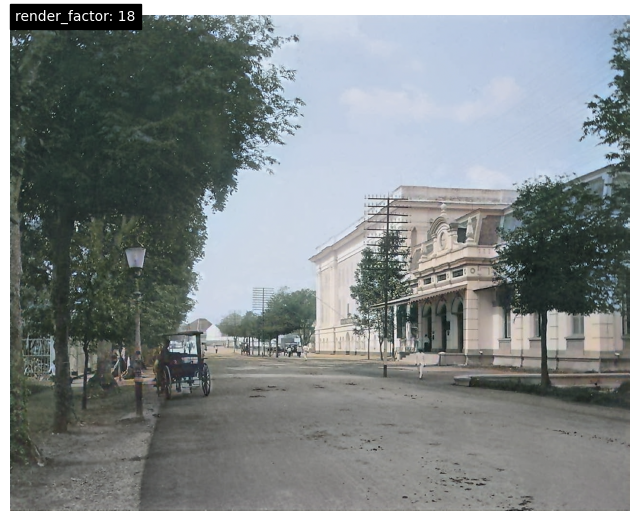

...

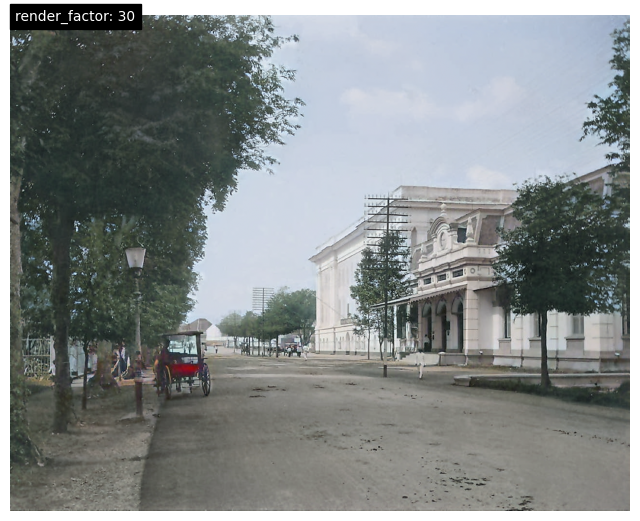

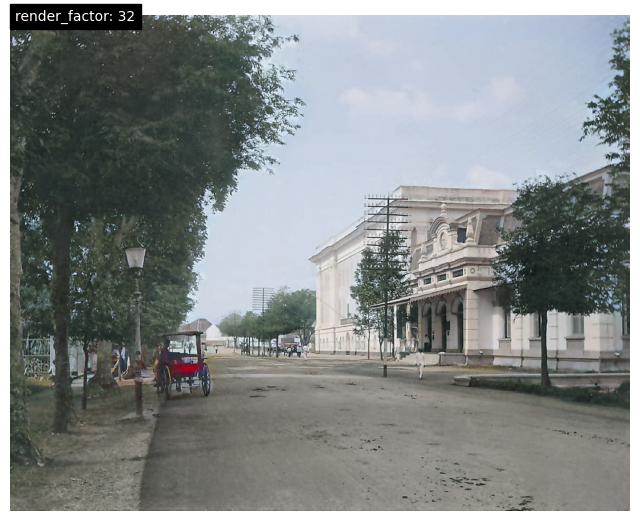

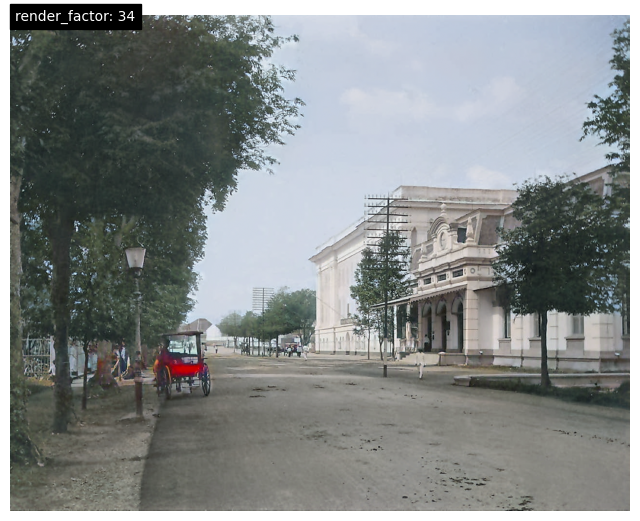

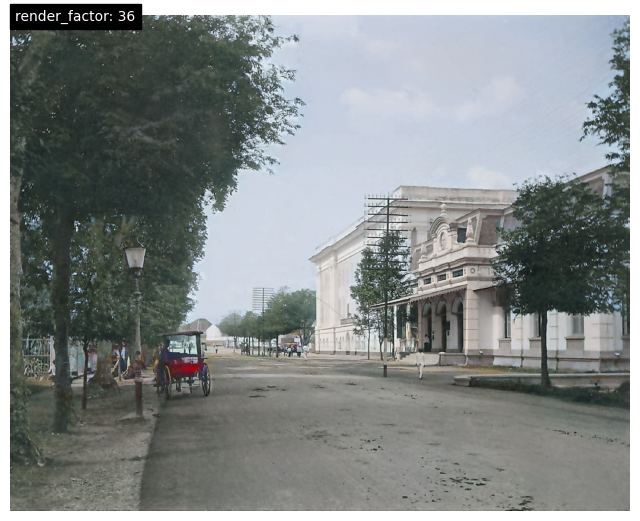

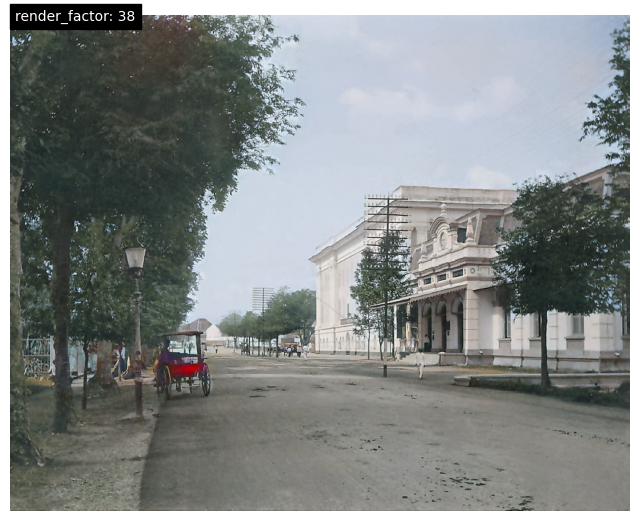

In [30]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('Kantor_Pos_dan_gubernuran.jpg', render_factor=i, display_render_factor=True, figsize=(8,8))

In [ ]:
!wget https://data.deepai.org/deoldify/ColorizeVideo_gen.pth -O ./models/ColorizeVideo_gen.pth

In [ ]:
colorizer = get_video_colorizer()

In [ ]:
source_url = 'https://www.youtube.com/watch?v=iQpHPwQa-7E'
render_factor = 21
watermarked = True
video_path = colorizer.colorize_from_url(source_url, 'video.mp4', render_factor, watermarked=watermarked)
show_video_in_notebook(video_path)